In [7]:
import pickle
import os
from notebook_utils import plot_dendogram_and_tsne, explain_predictions
import sys
sys.path.append('..')
from utils import get_texts, Tokenizer, DataGenerator, lstm_model
from log import logger

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Get Hiddens

In [8]:
main_dir = '..'
feature_type = 'clause_type'
character_level = False
language = 'hebrew'
seq_len = 32
batch_size = 1
lstm_dim = 256
domain = 'Q'

In [9]:
!ls ../data/hidden_states

clause_type_hebrew_lstm_256_seq_len_32.pkl
clause_type_hebrew_lstm_256_seq_len_32_N.pkl
clause_type_hebrew_lstm_256_seq_len_32_Q.pkl
phrase_function_hebrew_lstm_256_seq_len_14_N.pkl
phrase_function_hebrew_lstm_256_seq_len_32.pkl
phrase_function_hebrew_lstm_256_seq_len_32_Q.pkl
verbal_stem_hebrew_lstm_256_seq_len_32.pkl
verbal_stem_hebrew_lstm_256_seq_len_32_Q.pkl
verbal_stem_hebrew_lstm_256_seq_len_8_N.pkl
word_english_lstm_512_seq_len_32.pkl
word_hebrew_lstm_512_seq_len_32.pkl
word_pos_hebrew_lstm_256_seq_len_32.pkl


In [12]:
path = os.path.join('..', 'data', 'hidden_states', f'{feature_type}_{language}_lstm_{lstm_dim}_seq_len_{seq_len}_{domain}.pkl')

with open(path, 'rb') as f:
    hiddens = pickle.load(f)
    
    
    
path = os.path.join('..', 'data', 'predictions', f'{feature_type}_{language}_lstm_{lstm_dim}_seq_len_{seq_len}_{domain}.pkl')

with open(path, 'rb') as f:
    predictions = pickle.load(f)

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


Variance PCA: 0.957007884979248


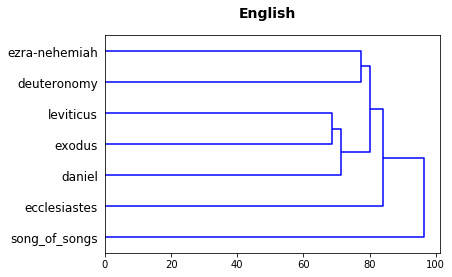

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 448 samples in 0.001s...
[t-SNE] Computed neighbors for 448 samples in 0.042s...
[t-SNE] Computed conditional probabilities for sample 448 / 448
[t-SNE] Mean sigma: 3.176026
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.064201


matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


[t-SNE] KL divergence after 1000 iterations: 0.697025


matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


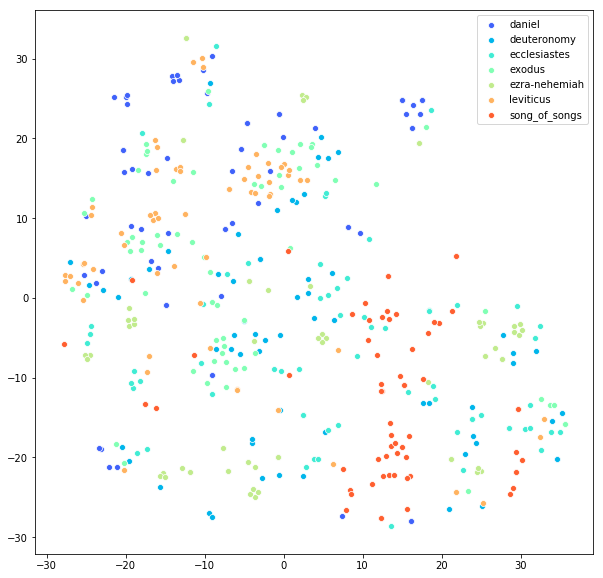

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


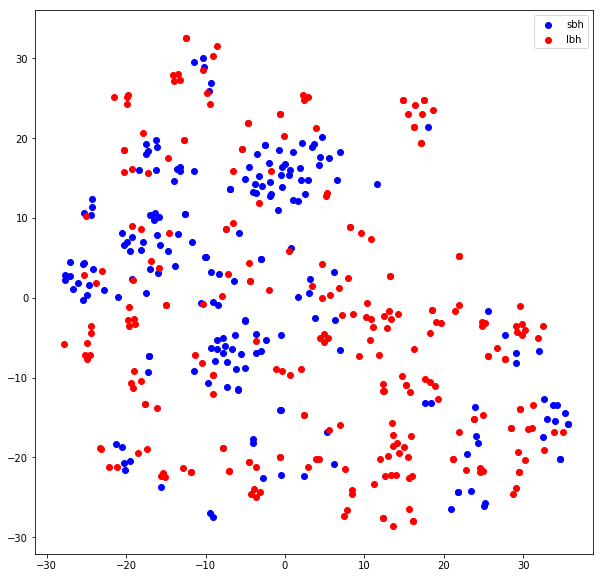

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


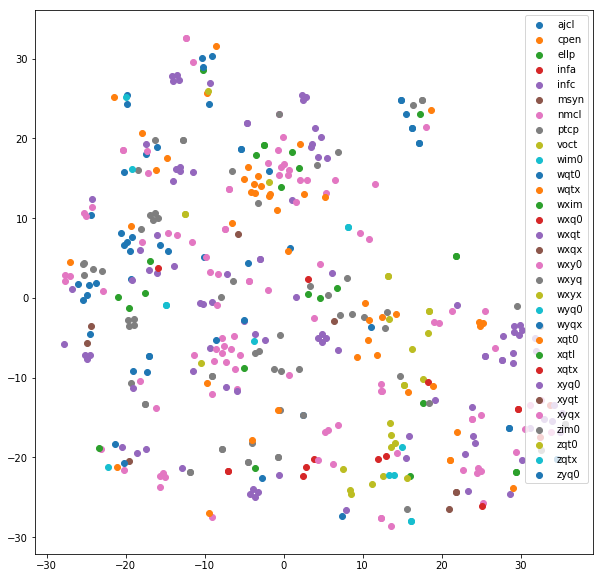

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


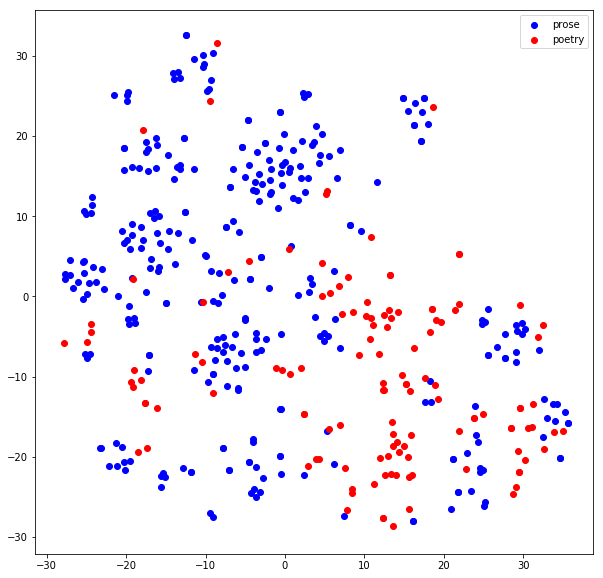

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


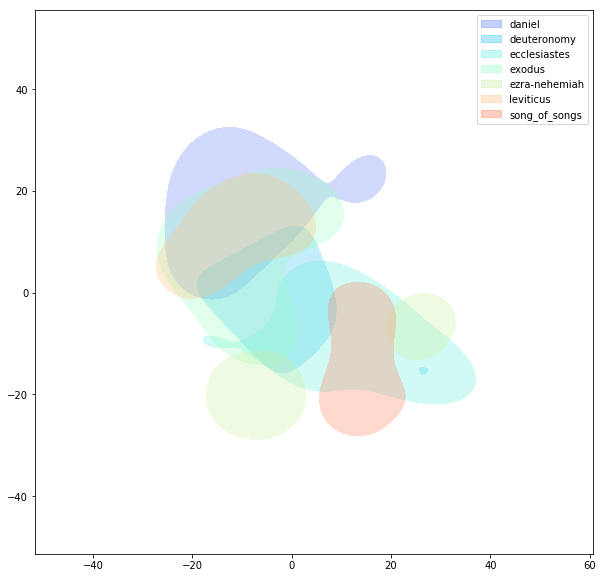

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


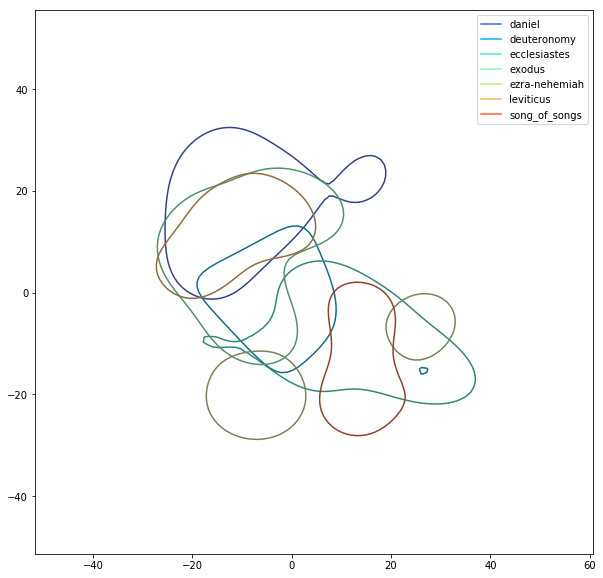

In [13]:
plot_dendogram_and_tsne(hiddens, f'{feature_type} {domain}', predictions=predictions, pca_components=128)

# Explain Predictions

In [17]:



texts = get_texts(main_dir, language, feature_type, character_level, domain=domain)
tokenizer = Tokenizer(texts.values(), character_level=character_level)
test_generator = DataGenerator(tokenizer,
                               tokenizer.full_text,
                               seq_len=seq_len,
                               batch_size=batch_size,
                               with_embedding=True,
                               train=False)



file_path = os.path.join(main_dir, 'models',
                         f'{feature_type}_{language}_lstm_{lstm_dim}')

if domain:
    file_path += f'_{domain}'

if character_level:
    file_path += '_character_level'

file_path += '.h5'

logger.info(f"Loading {file_path}")

prediction_model = lstm_model(num_words=tokenizer.num_words,
                              lstm_dim=lstm_dim,
                              seq_len=1,
                              batch_size=batch_size,
                              stateful=True,
                              return_state=False,
                              flatten=True)

prediction_model.load_weights(file_path)


root - INFO - Full text sample: xqtl xqt0 xqtl infc nmcl xqtx in
root - INFO - Length of tokenizer: 42
root - INFO - Setting up testing generator...
root - INFO - Length of encoded texts: 3129
root - INFO - Number of sequences: 619
root - INFO - Loading ../models/clause_type_hebrew_lstm_256_Q.h5


In [20]:
file_name = f'{feature_type}_{language}_lstm_{lstm_dim}_seq_len_{seq_len}'

if domain:
    file_name += f'_{domain}'

if character_level:
    file_name += '_character-level'
file_name += '.pkl'


seeds_path = os.path.join(main_dir, 'data', 'seeds', file_name)

with open(seeds_path, 'rb') as f:
    seeds = pickle.load(f)

In [21]:
explain_predictions(seeds, prediction_model, tokenizer)



------------------------------

Explanations for daniel


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for deuteronomy


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for ecclesiastes


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for exodus


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for ezra-nehemiah


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for leviticus


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for song_of_songs


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
